# **Lab 2.1 Image Enhancement with Math Operation**
This lab consists of two main subparts: Image Pixel Adjustment using Linear Equations and Gamma Equations.

In [1]:
import cv2
import matplotlib.pyplot as plt
import numpy as np
from mpl_toolkits.axes_grid1 import ImageGrid
import os
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

Read an image using OpenCV (Use your own image).

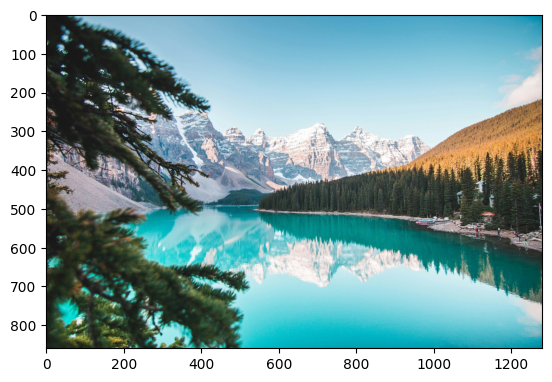

In [2]:
### START CODE HERE ###
img = cv2.imread('../images/pexels-jaime-reimer-1376930-2662116.jpg')[:,:,::-1]


plt.imshow(img)
### END CODE HERE ###

## **Image Pixel Adjustment**

### Using Linear Equation
$$I_{new} = I \cdot a + b$$

Please perform at ***least 20 iterations*** with varying values of $a$ and $b$.
Assign the result of each iteration to an array.<br/>

In [3]:
# img_int32 = img.astype(np.int32)
# lin_result_ab = np.clip([img_int32*(i/10) + i for i in range(-10, 10)], -255, 255).astype(np.uint8)
# lin_result_a = np.clip([img_int32*(i/10) for i in range(-10, 10)], -255, 255).astype(np.uint8)
# lin_result_b = np.clip([img_int32 + i for i in range(-10, 10)], -255, 255).astype(np.uint8)

In [4]:
### START CODE HERE ###

lin_result = np.clip(np.array([img*(i/10) + i for i in range(0, 20)]), 0, 255).astype(np.uint8)

### END CODE HERE ###

Plot the images in a grid as shown below. Using `ImageGrid`.
<details>

<summary>
<font size="3" color="orange">
<b>Expected output</b>
</font>
</summary>

- The output should resemble this, but not be identical
- The reference output used 40 iterations.

![image-2.png](https://github.com/Digital-Image-Processing-Laboratory/image_processing-2024/blob/master/Lab2_Image-Enhancement/assets/1-1.png?raw=true)
</details>


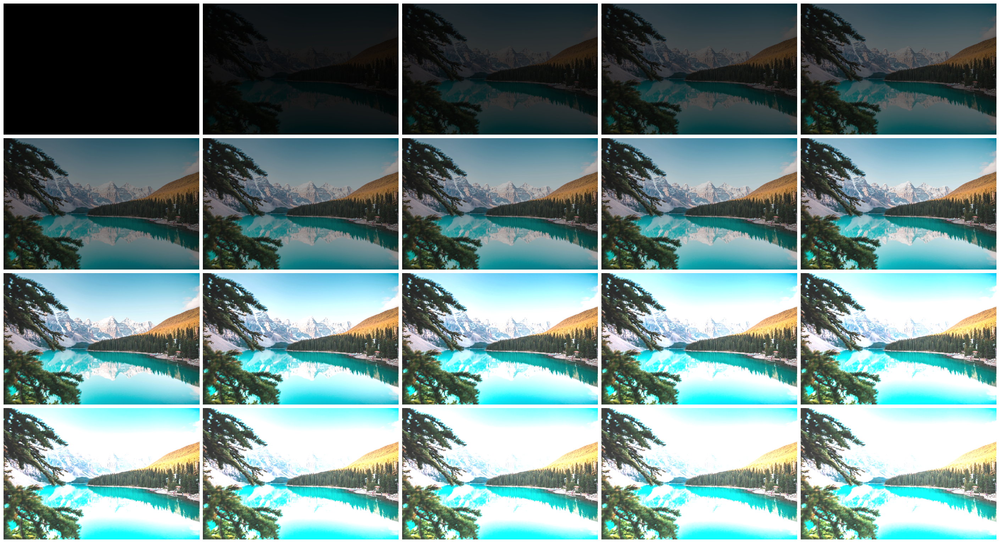

In [5]:
### START CODE HERE ###
def plot_image_grid(img_arr, shape=(4, 5)):
    fig = plt.figure(figsize=shape)
    grid = ImageGrid(fig, (0, 0, 7, 7), shape, axes_pad=0.1)

    for ax, im in zip(grid, img_arr):
        # Iterating over the grid returns the Axes.
        ax.imshow(im)
        ax.set_axis_off()
    plt.show()
    
plot_image_grid(lin_result)
### END CODE HERE ###

If you code work properly, the cell below should run without error.

In [6]:
assert len(lin_result) >= 20, f"Expected more than or equal 20 iterations but got {len(lin_result)}"
for idx, result in enumerate(lin_result):
    assert result.shape == img.shape, f"Shape mismatch at index {idx}. Expected {img.shape} but got {result.shape}"
    assert result.dtype == np.uint8, f"Data type mismatch at index {idx}. Expected uint8 but got {result.dtype}"
    assert np.all((result >= 0) & (result <= 255)), f"Pixel value out of bounds at index {idx}"

Save the array of images to a video. Please complete the function below.

In [7]:
### START CODE HERE ###
def write_images_to_video(image_array, output_file, frame_rate=10):
    fourcc = cv2.VideoWriter_fourcc(*'mp4v')
    height, width = image_array[0].shape[:2]
    out = cv2.VideoWriter(output_file, fourcc, frame_rate, (width, height))

    for image in image_array:
        out.write(image)
### END CODE HERE ###

Use `write_images_to_video()` and save the result.

In [8]:
output_folder = "output"
os.makedirs(output_folder, exist_ok=True)

output_file =  os.path.join(output_folder, "output_linear.mp4")
write_images_to_video(lin_result, output_file)

Now use `matplotlib.animation` to display the animation from the images array.

In [9]:
%%capture
### START CODE HERE ###
def create_animation(image_arr, interval=100):
    fig = plt.figure()
    artists = []
    for image in image_arr:
        artists.append([plt.imshow(image, animated=True)])

    ani = animation.ArtistAnimation(fig, artists, interval)
    return ani
    
ani = create_animation(lin_result)

### END CODE HERE ###

<details>
<summary>
<font size="3" color="orange">
<b>Expected output</b>
</font>
</summary>

- The output should resemble this, but not be identical

![linear.gif](![<attachment:linear (2).gif>](https://github.com/Digital-Image-Processing-Laboratory/image_processing-2024/blob/master/Lab2_Image-Enhancement/assets/linear.gif?raw=true))

</details>

In [10]:
display(HTML(ani.to_jshtml()))

### Gamma Equation
$$I_{new} = I^{\gamma} \cdot a + b$$

Where $a$ is 1 and $b$ is 0. 
Please perform ***at least 10 iterations*** for 0 < $\gamma$ < 1 and another ***at least 10 iterations*** for $\gamma$ > 1
Assign the result of each iteration to an array.<br/>


In [11]:
### START CODE HERE ###
a = 1
b = 0
gamma = np.arange(0, 2, 0.1)

gam_result = np.clip(np.array([(img/255)**(gamma[i]) for i in range(len(gamma))])*255, 0, 255).astype(np.uint8)

### END CODE HERE ###

Plot the images in a grid as shown below. Using `ImageGrid`.
<details>

<summary>
<font size="3" color="orange">
<b>Expected output</b>
</font>
</summary>

- The output should resemble this, but not be identical

![image-2.png](https://github.com/Digital-Image-Processing-Laboratory/image_processing-2024/blob/master/Lab2_Image-Enhancement/assets/1-2.png?raw=true)
</details>

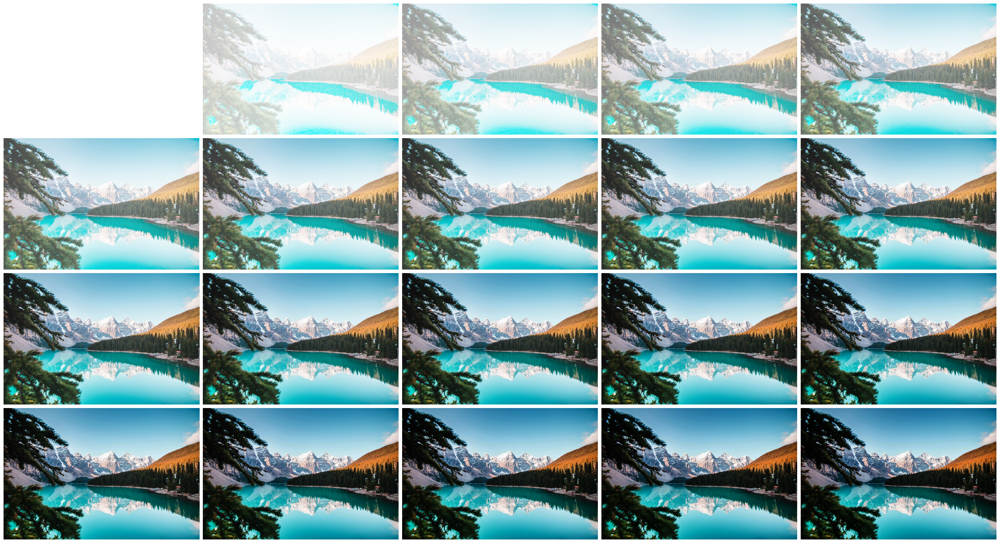

In [12]:
### START CODE HERE ###

plot_image_grid(gam_result)
### END CODE HERE ###

In [13]:
assert len(gam_result) >= 20, f"more than or equal 20 iterations but got {len(gam_result)}"
for idx, result in enumerate(gam_result):
    assert result.shape == img.shape, f"Shape mismatch at index {idx}. Expected {img.shape} but got {result.shape}"
    assert result.dtype == np.uint8, f"Data type mismatch at index {idx}. Expected uint8 but got {result.dtype}"
    assert np.all((result >= 0) & (result <= 255)), f"Pixel value out of bounds at index {idx}"

Use `write_images_to_video()` and save the result.

In [14]:
output_folder = "output"
os.makedirs(output_folder, exist_ok=True)

output_file =  os.path.join(output_folder, "output_gamma.mp4")
write_images_to_video(gam_result,output_file)

Now use `matplotlib.animation` to display the animation from the images array.

In [15]:
%%capture
### START CODE HERE ###
def create_animation(image_arr, interval=100):
    fig = plt.figure()
    artists = []
    for image in image_arr:
        artists.append([plt.imshow(image, animated=True)])

    ani = animation.ArtistAnimation(fig, artists, interval)
    return ani

ani = create_animation(gam_result)
### END CODE HERE ###

<details>
<summary>
<font size="3" color="orange">
<b>Expected output</b>
</font>
</summary>

- The output should resemble this, but not be identical

![gamma2.gif](https://github.com/Digital-Image-Processing-Laboratory/image_processing-2024/blob/master/Lab2_Image-Enhancement/assets/gamma.gif?raw=true)

</details>

In [16]:
display(HTML(ani.to_jshtml()))

---

## **Questions**
1. If an image having over brightness or saturation, what would be possible solutions to enhance the image.<br>
= จากสมการ $$I_{new} = I^{\gamma} \cdot a + b$$ เราสามารถใช้แกมมามีค่ามาก และ/หรือแอลฟาน้อย ๆ ในช่วง 0 <  แอลฟา < 1 และ/หรือใช้ค่า b ที่ติดลบ
2. How can we make an image reverse intensity (black-to-white, white-to-black)? Explain the process<br>
= นำ 255 มาลบค่าสี หรือนำค่าสีมาคูณ -1 แล้วแปลงเป็น uint

In [17]:
from utils import *

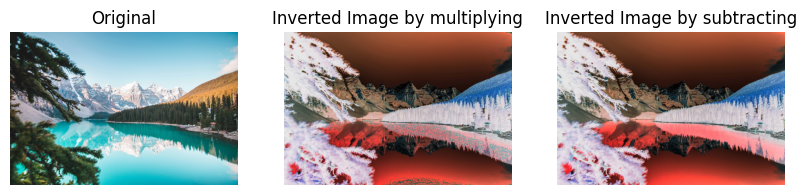

In [18]:
# code เพิ่มเติมข้อ 2
fig,axs = plt.subplots(1,3, figsize=(10,5))
subplot(axs[0], img, "Original")
subplot(axs[1], (-1*(img.astype(np.int32))).astype(np.uint8), "Inverted Image by multiplying")
subplot(axs[2], np.subtract(255, img), "Inverted Image by subtracting")